(a) (5 points) Data generation. Please refer to the illustration of two regions and corresponding labels as follows:

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import sys

In [ ]:
points = np.random.rand(100000, 2) * 10 - 5
dists_to_coord = np.sqrt(np.sum(points ** 2, axis=1))
labels = np.sqrt(np.sum((points - np.array([[0, 0]])) ** 2, axis=1)) <= 2.5

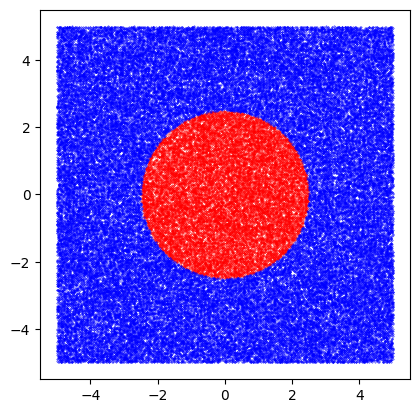

In [ ]:
plt.scatter(points[labels == 1, 0], points[labels == 1, 1], c='red', s=0.1)
plt.scatter(points[labels == 0, 0], points[labels == 0, 1], c='blue', s=0.1)
plt.axis('square')
plt.show()

(b) (5 points) Network design, implementation, training, and testing. Please report training loss, validation
accuracy at every epoch by a line graph and report the testing accuracy of the final model of the MLP
classifier.
+ Network design: The MLP should contain at least one hidden layer, with at most 50 perceptrons (excluding
perceptrons for input and output layers).
+ Training method: The MLP must be trained using Cross Entropy Loss, Adam optimizer with a learning
rate of 0.001, mini-batch size of 128 samples, and in at most 20 epochs.

In [ ]:
points = np.random.rand(100000, 2) * 10 - 5
labels = np.sqrt(np.sum((points - np.array([[0, 0]])) ** 2, axis=1)) <= 2.5
train_dataset = torch.utils.data.TensorDataset(torch.as_tensor(points, dtype=torch.float32), torch.as_tensor(labels, dtype=torch.float32).unsqueeze(-1))
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=128, shuffle=True)

points = np.random.rand(20000, 2) * 10 - 5
labels = np.sqrt(np.sum((points - np.array([[0, 0]])) ** 2, axis=1)) <= 2.5
val_dataset = torch.utils.data.TensorDataset(torch.as_tensor(points, dtype=torch.float32), torch.as_tensor(labels, dtype=torch.float32).unsqueeze(-1))
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=128, shuffle=False)


points = np.random.rand(20000, 2) * 10 - 5
labels = np.sqrt(np.sum((points - np.array([[0, 0]])) ** 2, axis=1)) <= 2.5
test_dataset = torch.utils.data.TensorDataset(torch.as_tensor(points, dtype=torch.float32), torch.as_tensor(labels, dtype=torch.float32).unsqueeze(-1))
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=128, shuffle=False)

Epoch 0. Training Loss: 0.25416600704193115
Epoch 0. Validation Loss: 0.22906277893455165

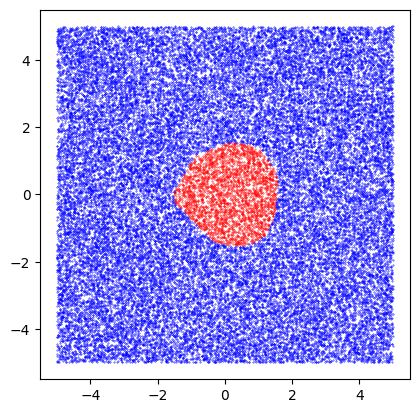

Epoch 1. Training Loss: 0.11797655373811722
Epoch 1. Validation Loss: 0.10265012607452975

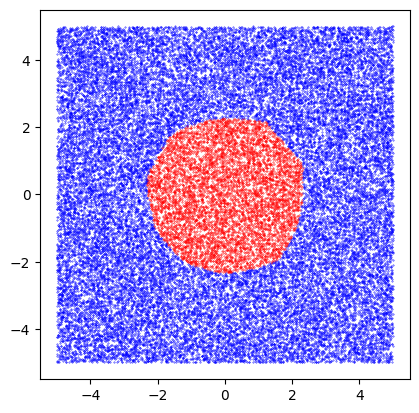

Epoch 2. Training Loss: 0.037820182740688324
Epoch 2. Validation Loss: 0.06724402555234872

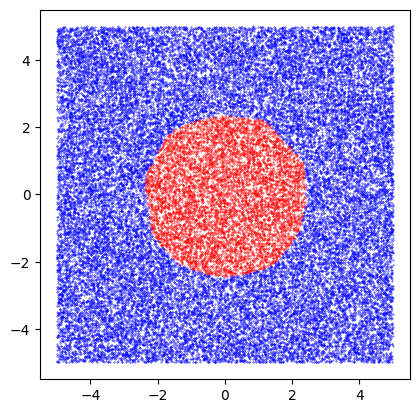

Epoch 3. Training Loss: 0.055199265480041504
Epoch 3. Validation Loss: 0.05197211587504976

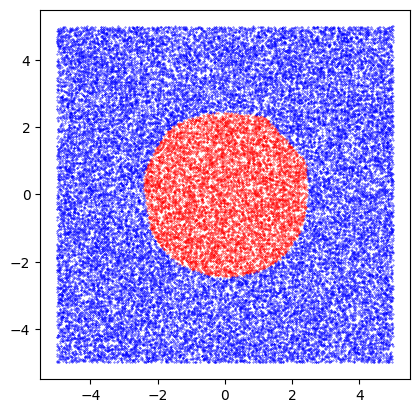

Epoch 4. Training Loss: 0.04422851651906967
Epoch 4. Validation Loss: 0.04254983185203212

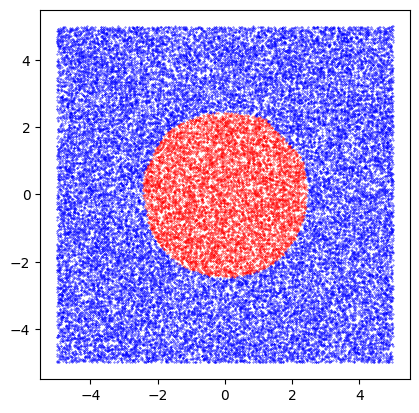

Epoch 5. Training Loss: 0.05827946215867996
Epoch 5. Validation Loss: 0.03699179363858168

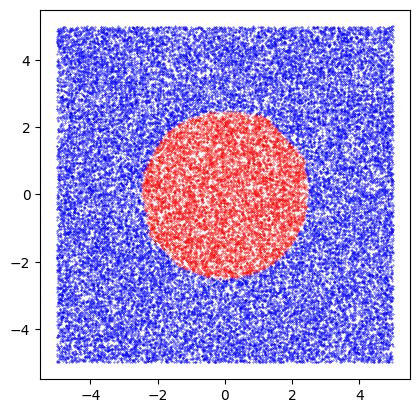

Epoch 6. Training Loss: 0.015624783001840115
Epoch 6. Validation Loss: 0.032916062956403015

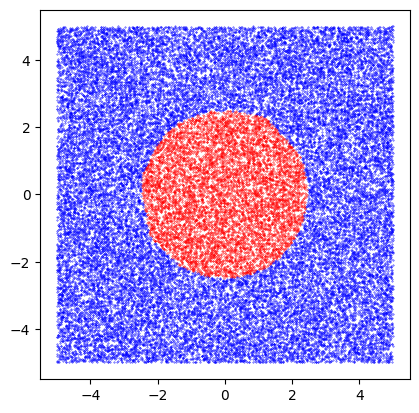

Epoch 7. Training Loss: 0.005790596827864647
Epoch 7. Validation Loss: 0.02936115082661817

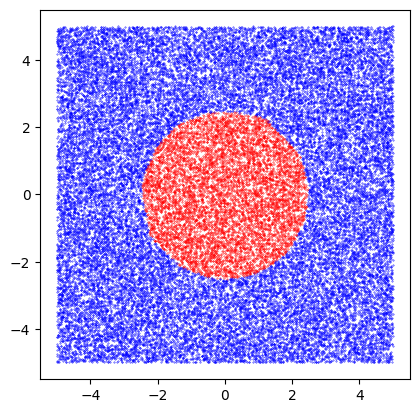

Epoch 8. Training Loss: 0.005309197120368481
Epoch 8. Validation Loss: 0.027059224001161612

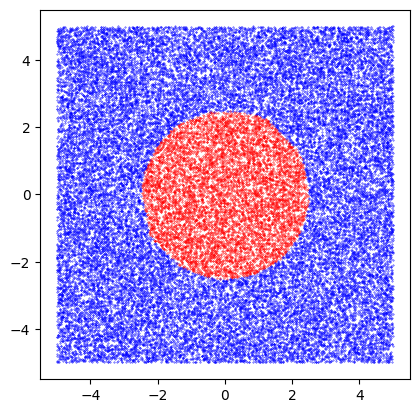

Epoch 9. Training Loss: 0.017397142946720123
Epoch 9. Validation Loss: 0.02509551898689027

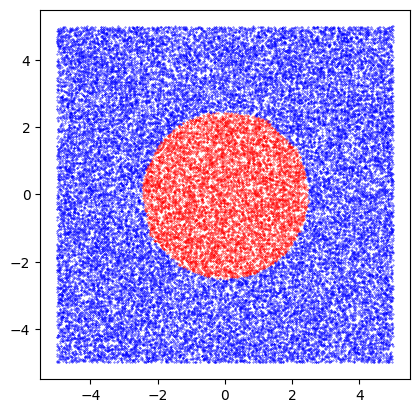

Epoch 10. Training Loss: 0.02610304020345211
Epoch 10. Validation Loss: 0.023693388434732038

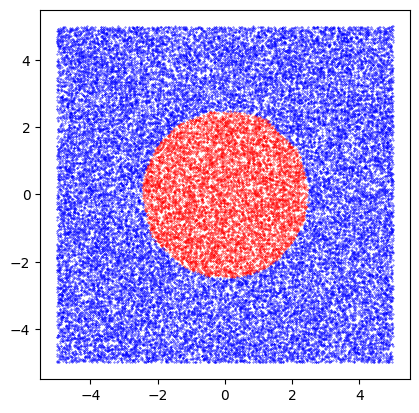

Epoch 11. Training Loss: 0.020732536911964417
Epoch 11. Validation Loss: 0.022355447149580453

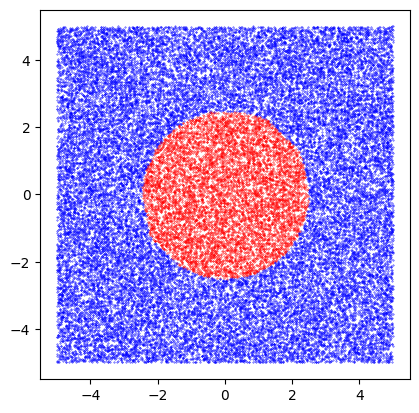

Epoch 12. Training Loss: 0.023558177053928375
Epoch 12. Validation Loss: 0.021145196477319026

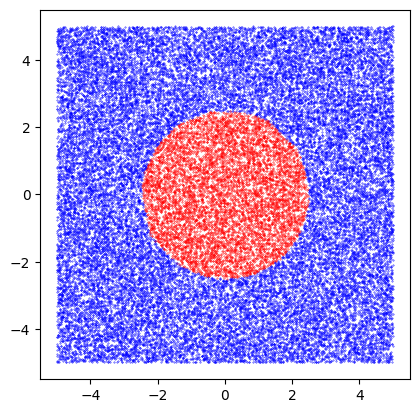

Epoch 13. Training Loss: 0.013775144703686237
Epoch 13. Validation Loss: 0.020391042065468563

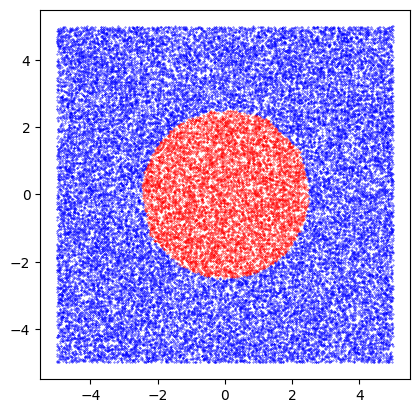

Epoch 14. Training Loss: 0.03031538613140583
Epoch 14. Validation Loss: 0.019783569748993892

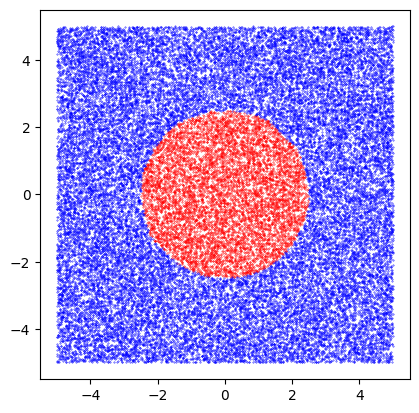

Epoch 15. Training Loss: 4.001982233603485e-05
Epoch 15. Validation Loss: 0.01884755966769662

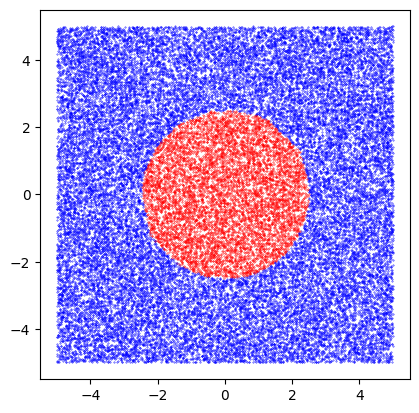

Epoch 16. Training Loss: 0.01363644190132618
Epoch 16. Validation Loss: 0.018162192812391148

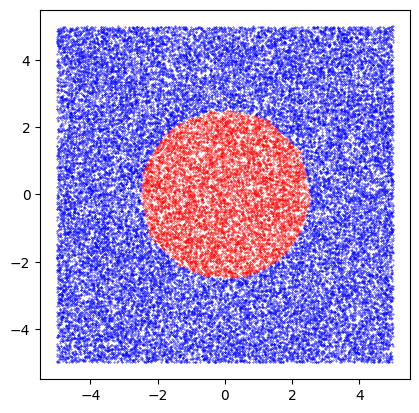

Epoch 17. Training Loss: 0.016175366938114166
Epoch 17. Validation Loss: 0.01750643693717422

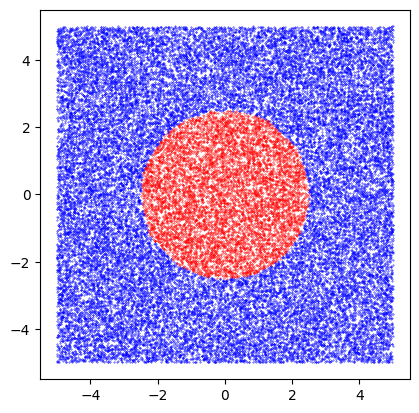

Epoch 18. Training Loss: 0.01473910454660654
Epoch 18. Validation Loss: 0.01712593758941456

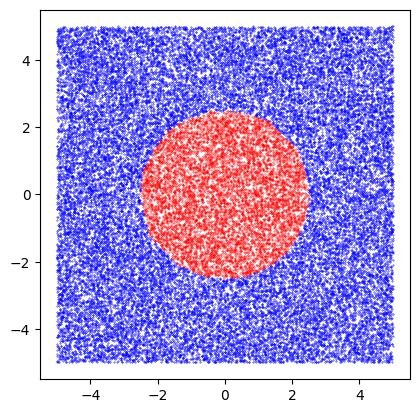

Epoch 19. Training Loss: 0.00227358634583652
Epoch 19. Validation Loss: 0.01622893096535069

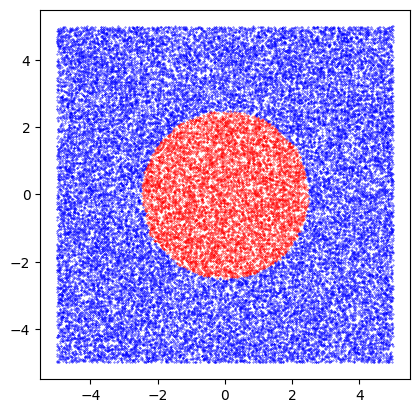

In [ ]:
model = torch.nn.Sequential(
    torch.nn.Linear(2, 20),
    torch.nn.LeakyReLU(),
    torch.nn.Linear(20, 1),
    torch.nn.Sigmoid(),
).cuda()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
criterion = torch.nn.BCELoss()
losses=[]
validation_accuracy = []
test_accuracy = []
for epoch in range(20):
    plt.clf()
    for points, labels in train_loader:
        preds = model(points.cuda())
        loss = criterion(preds, labels.cuda())
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        sys.stdout.write(f'\rEpoch {epoch}. Training Loss: {loss.item()}')
        sys.stdout.flush()
    losses.append(loss.detach().cpu().numpy())

    with torch.no_grad():
        total_val_loss = 0.0
        acc_avg = 0
        for points, labels in val_loader:
            preds = model(points.cuda())
            total_val_loss += criterion(preds, labels.cuda())
            preds = preds.squeeze(1).detach().cpu().numpy()
            points = points.detach().numpy()

            acc = 0
            for i in range(preds.shape[0]):
              if labels[i]==0 and preds[i]<0.5:
                 acc+=1
              elif labels[i]==1 and preds[i]>=0.5:
                acc+=1
            acc = acc/128
            acc_avg += acc
            plt.scatter(points[preds >= 0.5, 0], points[preds >= 0.5, 1], c='red', s=0.1)
            plt.scatter(points[preds < 0.5, 0], points[preds < 0.5, 1], c='blue', s=0.1)
        validation_accuracy.append(acc_avg/len(val_loader))

        avg_val_loss = total_val_loss.item() / len(val_loader)
        print()
        sys.stdout.write(f'\rEpoch {epoch}. Validation Loss: {avg_val_loss}')
        sys.stdout.flush()
    avg_test_total = []
    with torch.no_grad():
        total_test_loss = 0.0
        acc_avg_test = 0
        for points, labels in test_loader:
            preds = model(points.cuda())
            total_test_loss += criterion(preds, labels.cuda())
            preds = preds.squeeze(1).detach().cpu().numpy()
            #if points[preds>=0.5, 0]
            #pred+=1

            acc_test = 0
            for i in range(preds.shape[0]):
              if labels[i]==0 and preds[i]<0.5:
                acc_test+=1
              elif labels[i]==1 and preds[i]>=0.5:
                acc_test+=1
            acc_test = acc_test/128
            acc_avg_test += acc_test

            points = points.detach().numpy()
            labels=labels.squeeze()
            plt.scatter(points[preds >= 0.5, 0], points[preds >= 0.5, 1], c='red', s=0.1)
            plt.scatter(points[preds < 0.5, 0], points[preds < 0.5, 1], c='blue', s=0.1)
            avg_test_loss = total_test_loss.item() / len(test_loader)
            avg_test_total.append(avg_test_loss)
        test_accuracy.append(acc_avg_test/len(test_loader))

        #sys.stdout.write(f'\rEpoch {epoch}. Testing Loss: {avg_test_loss}')
        sys.stdout.flush()
    plt.axis('square')
    plt.show()

Text(0, 0.5, 'Loss')

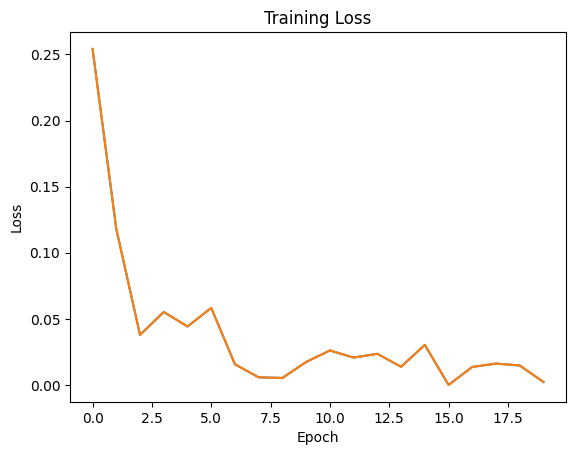

In [ ]:
import matplotlib.pyplot as plt

#plt.figure(figsize=(12, 4))
#plt.subplot(1, 2, 1)
plt.plot(range(len(losses)), losses)
plt.title('Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')

plt.plot(range(len(losses)), losses)
plt.title('Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')


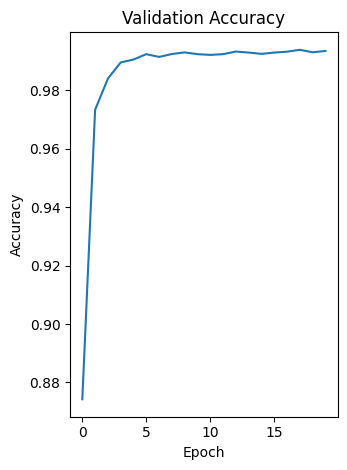

In [ ]:

plt.subplot(1, 2, 2)
plt.plot(range(len(validation_accuracy)), validation_accuracy)
plt.title('Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')

plt.tight_layout()
plt.show()

In [ ]:
#the testing accuracy of the final model of the MLP classifier
print(test_accuracy[-1])

0.992734872611465


(a) (10 points) Data generation.

In [7]:
!wget https://user-images.githubusercontent.com/29124670/266203829-06705829-b2a2-472d-8186-313b6322afb8.jpg -O bear_binary.jpg

import cv2
from google.colab.patches import cv2_imshow

# bear_img = cv2.imread("bear_binary.jpg")
# cv2_imshow(bear_img)

--2023-10-03 22:13:53--  https://user-images.githubusercontent.com/29124670/266203829-06705829-b2a2-472d-8186-313b6322afb8.jpg
Resolving user-images.githubusercontent.com (user-images.githubusercontent.com)... 185.199.110.133, 185.199.108.133, 185.199.109.133, ...
Connecting to user-images.githubusercontent.com (user-images.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 38071 (37K) [image/jpeg]
Saving to: ‘bear_binary.jpg’

bear_binary.jpg     100%[===================>]  37.18K  --.-KB/s    in 0.001s  

2023-10-03 22:13:53 (24.5 MB/s) - ‘bear_binary.jpg’ saved [38071/38071]



In [8]:
from PIL import Image

In [9]:
bear_img=Image.open("bear_binary.jpg")

In [10]:
def get_pixel_fromxy(bear_img,xy:tuple[float,float])->int:
  w=bear_img.width-1
  h=bear_img.height-1

  p_x=w*(1/2)*(xy[0]+1)
  p_y=h*(1/2)*(-xy[1]-1)

  p=bear_img.getpixel((p_x,p_y))

  return 1*(p>128)

In [11]:
points = np.random.rand(100000, 2) * 2 - 1
labels =np.array([get_pixel_fromxy(bear_img,xy=(i[0],i[1])) for i in points])

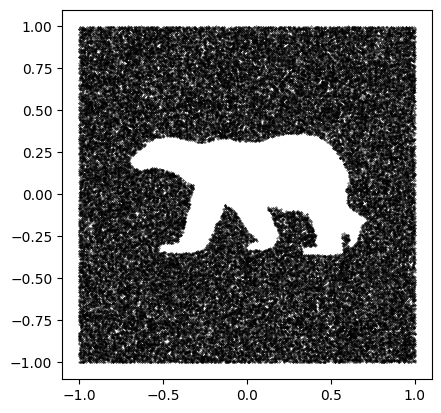

In [12]:
plt.scatter(points[labels == 1, 0], points[labels == 1, 1], c='white', s=0.1)
plt.scatter(points[labels == 0, 0], points[labels == 0, 1], c='black', s=0.1)
plt.axis('square')
plt.show()

(b) (10 points) Network design, implementation, training, and testing. Please report training loss, validation
accuracy at every epoch by a line graph and report the testing accuracy of the final model of the MLP
classifier.
+ Network design: The MLP should contain at least one hidden layer, with at most 500 perceptrons
(excluding perceptrons for input and output layers).
+ Training method: The MLP must be trained using Cross Entropy Loss, Adam optimizer with a learning
rate of 0.001, mini-batch size of 128 samples, and in at most 100 epochs.

In [13]:
points = np.random.rand(100000, 2) * 2 - 1
labels =np.array([get_pixel_fromxy(bear_img,xy=(i[0],i[1])) for i in points])
train_dataset = torch.utils.data.TensorDataset(torch.as_tensor(points, dtype=torch.float32), torch.as_tensor(labels, dtype=torch.float32).unsqueeze(-1))
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=128, shuffle=True)

points = np.random.rand(20000, 2) * 2 - 1
labels =np.array([get_pixel_fromxy(bear_img,xy=(i[0],i[1])) for i in points])
val_dataset = torch.utils.data.TensorDataset(torch.as_tensor(points, dtype=torch.float32), torch.as_tensor(labels, dtype=torch.float32).unsqueeze(-1))
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=128, shuffle=False)


points = np.random.rand(20000, 2) * 2 - 1
labels =np.array([get_pixel_fromxy(bear_img,xy=(i[0],i[1])) for i in points])
test_dataset = torch.utils.data.TensorDataset(torch.as_tensor(points, dtype=torch.float32), torch.as_tensor(labels, dtype=torch.float32).unsqueeze(-1))
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=128, shuffle=False)

Epoch 0. Training Loss: 0.03043614700436592
Epoch 0. Validation Loss: 0.05876428762059303

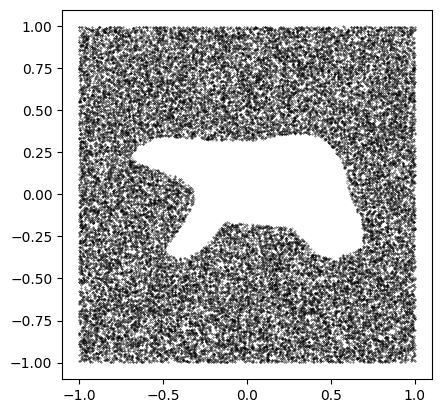

Epoch 1. Training Loss: 0.0851694867014885
Epoch 1. Validation Loss: 0.05325601662799811

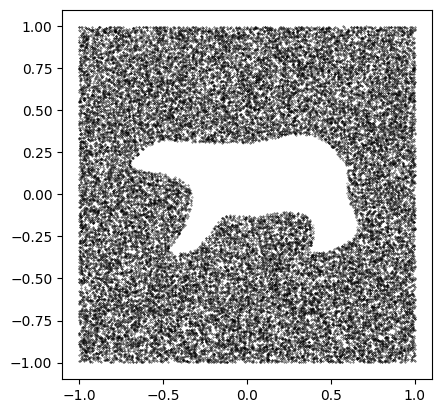

Epoch 2. Training Loss: 0.0007407193188555539
Epoch 2. Validation Loss: 0.04110352400761501

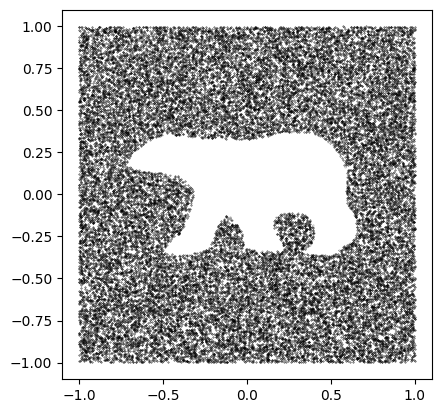

Epoch 3. Training Loss: 0.04452717304229736
Epoch 3. Validation Loss: 0.030131695376839608

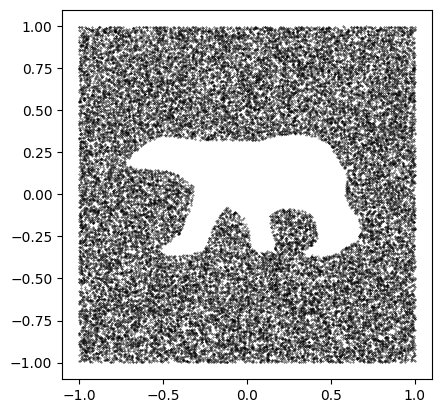

Epoch 4. Training Loss: 0.06638392806053162
Epoch 4. Validation Loss: 0.028794640948058694

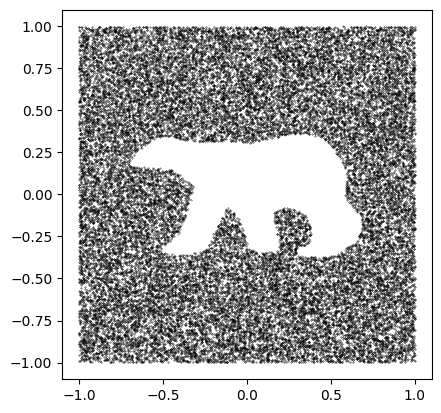

Epoch 5. Training Loss: 0.003139437874779105
Epoch 5. Validation Loss: 0.041008326658018075

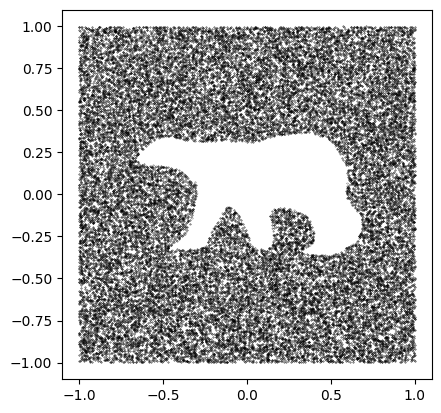

Epoch 6. Training Loss: 0.0022947255056351423
Epoch 6. Validation Loss: 0.052918282284098825

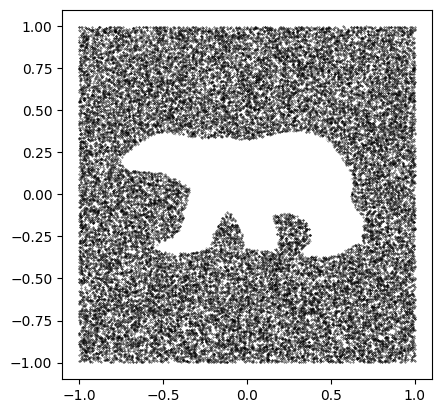

Epoch 7. Training Loss: 0.01374899223446846
Epoch 7. Validation Loss: 0.026652005068056143

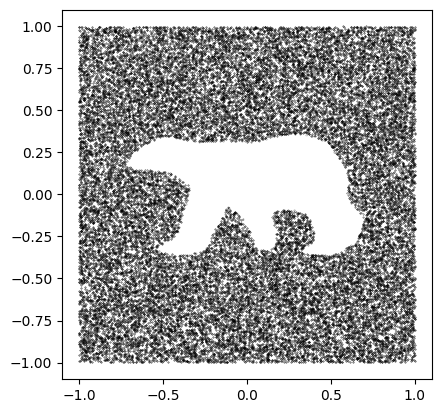

Epoch 8. Training Loss: 0.027399014681577682
Epoch 8. Validation Loss: 0.026430114818986054

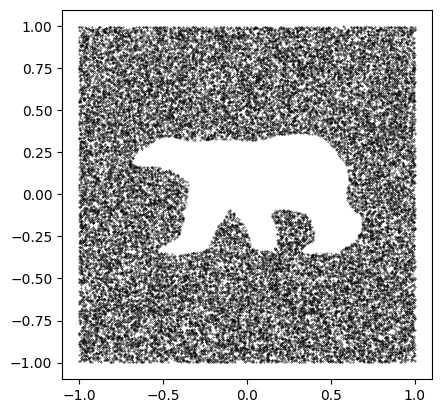

Epoch 9. Training Loss: 0.018263129517436028
Epoch 9. Validation Loss: 0.02554215595221064

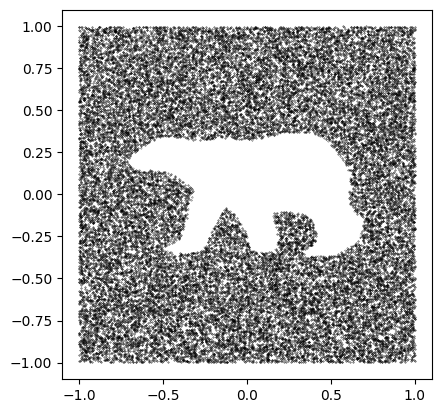

Epoch 10. Training Loss: 0.02456805296242237
Epoch 10. Validation Loss: 0.021326021024375964

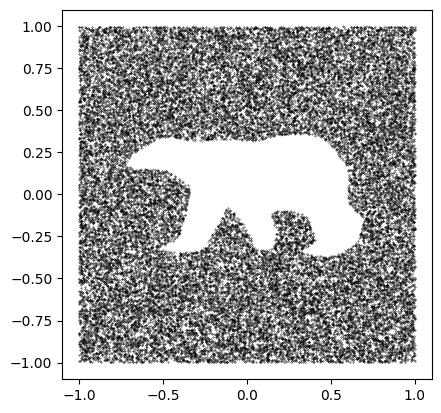

Epoch 11. Training Loss: 0.007734125945717096
Epoch 11. Validation Loss: 0.031159303750202153

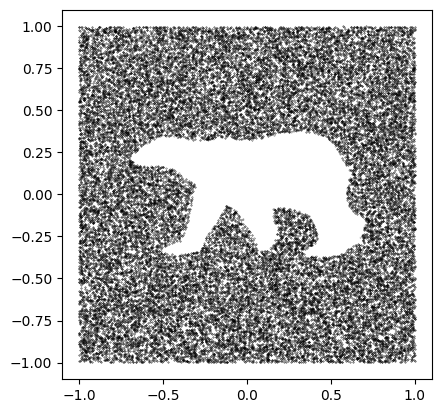

Epoch 12. Training Loss: 0.009294369257986546
Epoch 12. Validation Loss: 0.028993400039186903

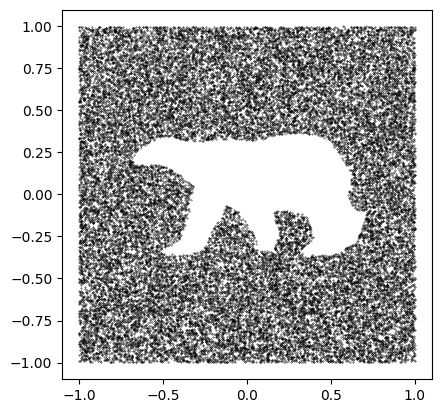

Epoch 13. Training Loss: 0.005399104207754135
Epoch 13. Validation Loss: 0.019076341276715515

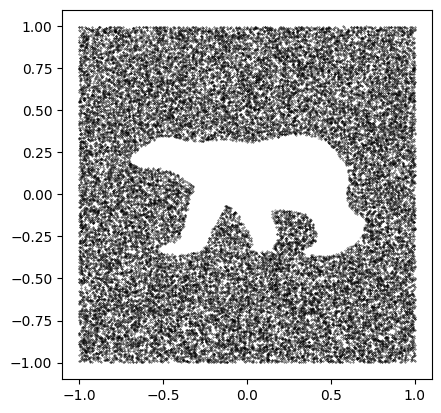

Epoch 14. Training Loss: 0.04823727533221245
Epoch 14. Validation Loss: 0.03107205469896839

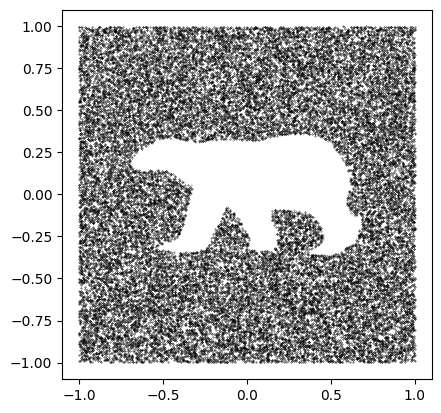

Epoch 15. Training Loss: 0.018989790230989456
Epoch 15. Validation Loss: 0.025064453197892304

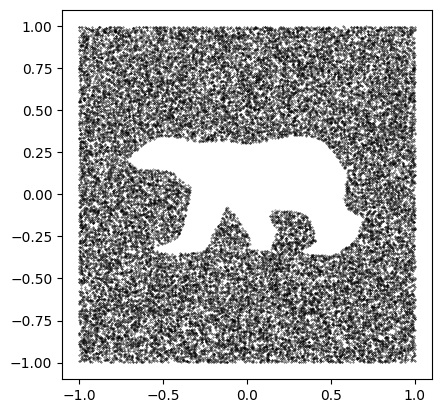

Epoch 16. Training Loss: 2.749390114331618e-05
Epoch 16. Validation Loss: 0.020656117967739227

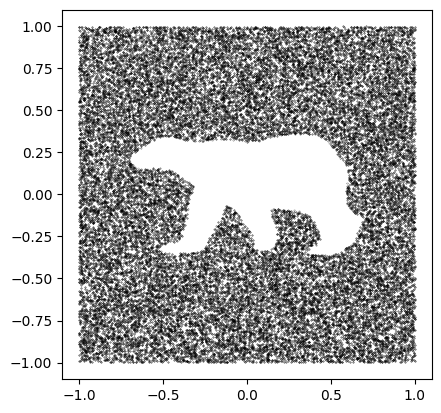

Epoch 17. Training Loss: 0.06757304072380066
Epoch 17. Validation Loss: 0.027819323691592856

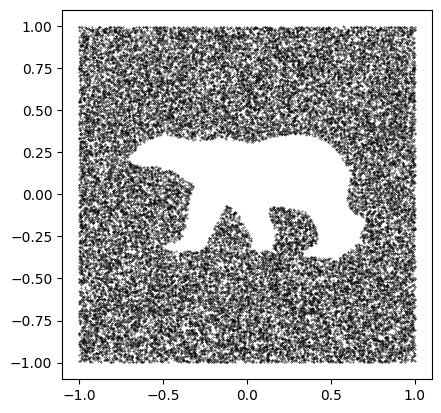

Epoch 18. Training Loss: 0.001953260973095894
Epoch 18. Validation Loss: 0.021202108662599212

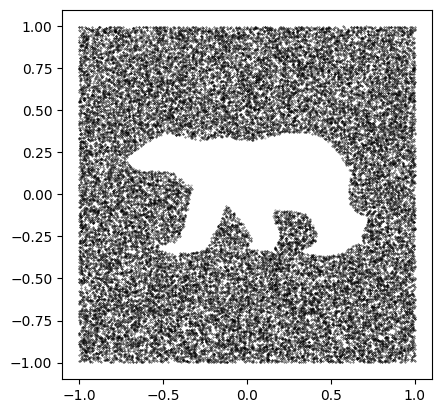

Epoch 19. Training Loss: 4.949683716404252e-05
Epoch 19. Validation Loss: 0.018612457688447017

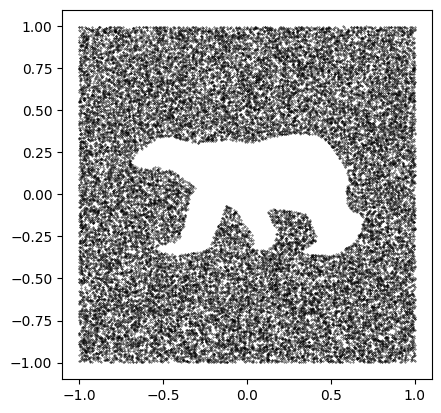

Epoch 20. Training Loss: 3.876787673107174e-07
Epoch 20. Validation Loss: 0.02073549920586264

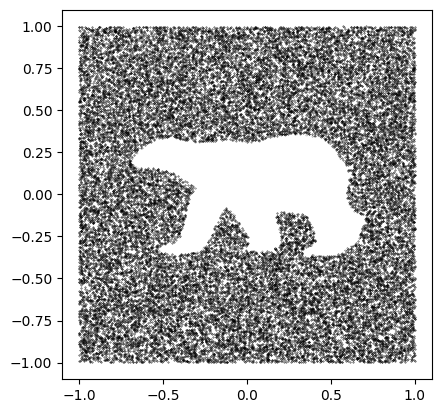

Epoch 21. Training Loss: 1.4612363884225488e-05
Epoch 21. Validation Loss: 0.018407606015539472

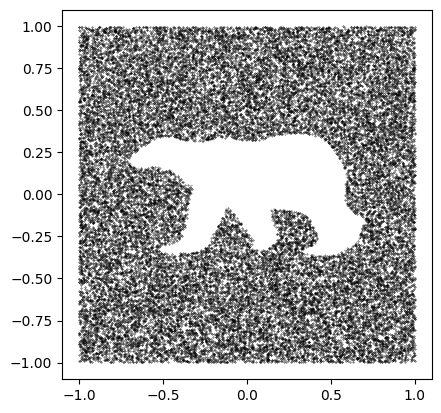

Epoch 22. Training Loss: 1.595730282133445e-05
Epoch 22. Validation Loss: 0.024605725221573168

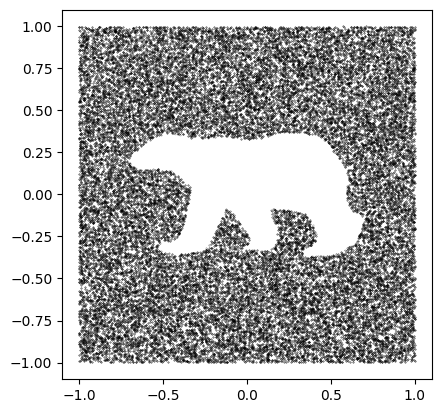

Epoch 23. Training Loss: 0.017803307622671127
Epoch 23. Validation Loss: 0.016020999592580614

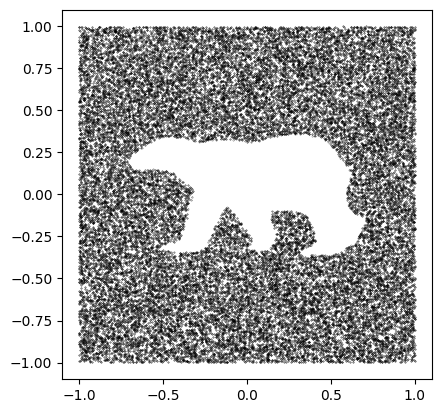

Epoch 24. Training Loss: 0.0078102294355630875
Epoch 24. Validation Loss: 0.017730603552168343

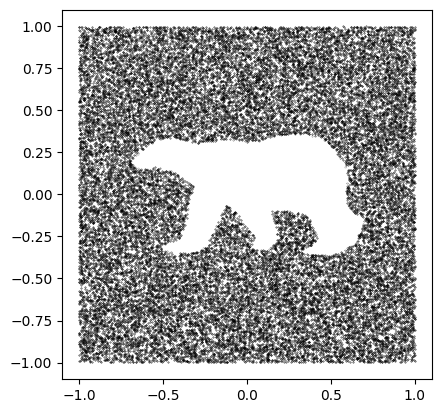

Epoch 25. Training Loss: 3.9694918086752295e-05
Epoch 25. Validation Loss: 0.019939197856149855

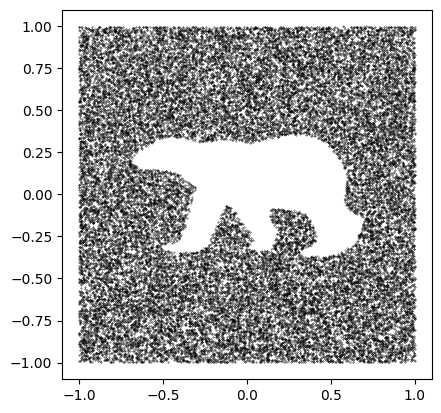

Epoch 26. Training Loss: 0.023083871230483055
Epoch 26. Validation Loss: 0.018326741115302796

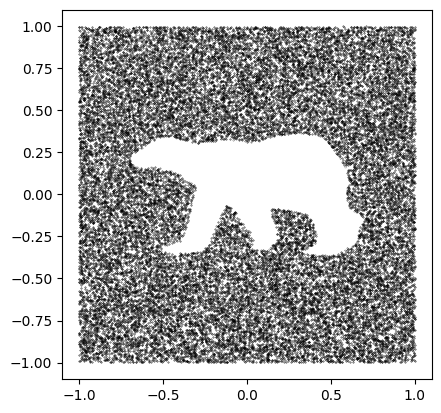

Epoch 27. Training Loss: 0.052162621170282364
Epoch 27. Validation Loss: 0.015424386710877631

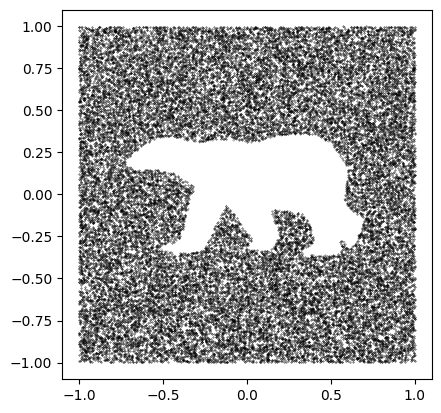

Epoch 28. Training Loss: 0.010047799907624722
Epoch 28. Validation Loss: 0.01845195338984204

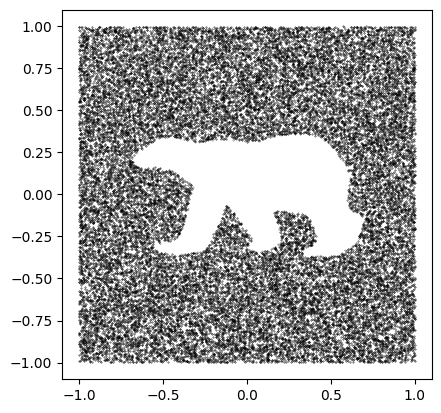

Epoch 29. Training Loss: 0.06750434637069702
Epoch 29. Validation Loss: 0.021054972508910356

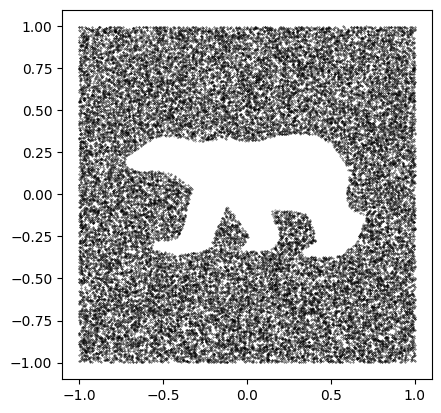

Epoch 30. Training Loss: 0.0025587391573935747
Epoch 30. Validation Loss: 0.01812774816136451

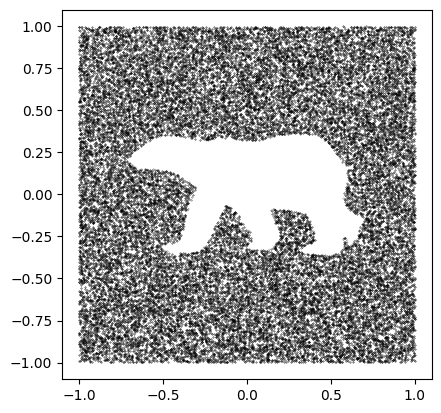

Epoch 31. Training Loss: 0.0001222423743456602
Epoch 31. Validation Loss: 0.016036326718178524

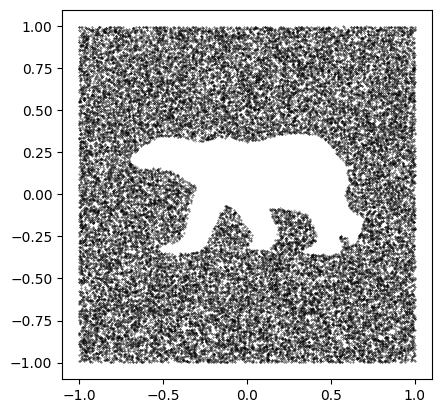

Epoch 32. Training Loss: 0.015568902716040611
Epoch 32. Validation Loss: 0.01627638841130931

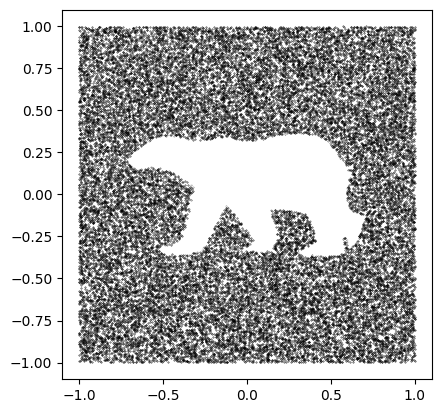

Epoch 33. Training Loss: 0.0003925646306015551
Epoch 33. Validation Loss: 0.015449692489235264

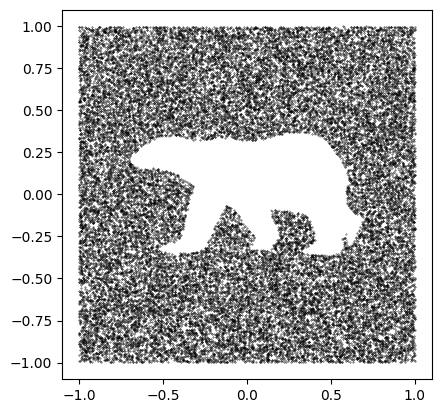

Epoch 34. Training Loss: 0.0062636095099151134
Epoch 34. Validation Loss: 0.016394042665032065

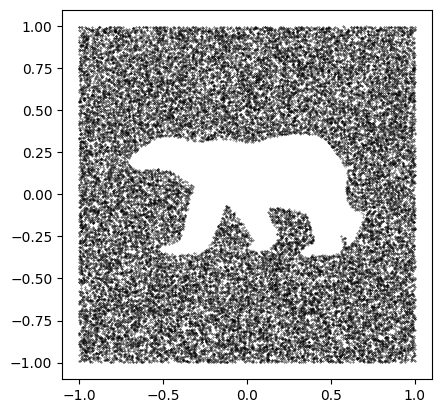

Epoch 35. Training Loss: 0.007843341678380966
Epoch 35. Validation Loss: 0.018609446325119895

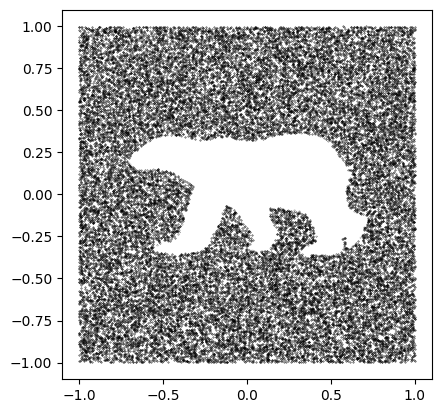

Epoch 36. Training Loss: 1.2758961929648649e-05
Epoch 36. Validation Loss: 0.01440216781227452

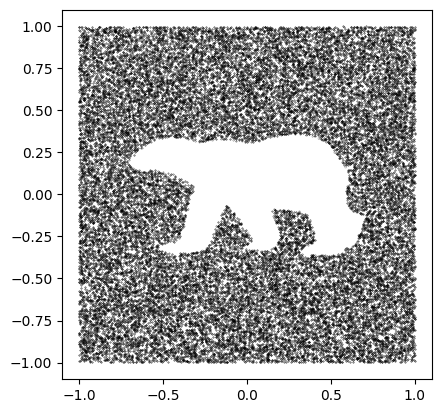

Epoch 37. Training Loss: 0.0231062863022089
Epoch 37. Validation Loss: 0.015978875433563428

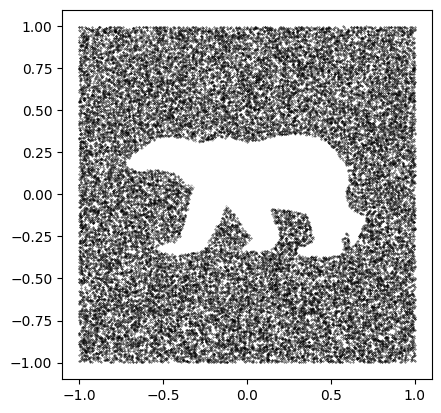

Epoch 38. Training Loss: 0.020343774929642677
Epoch 38. Validation Loss: 0.017752222194793117

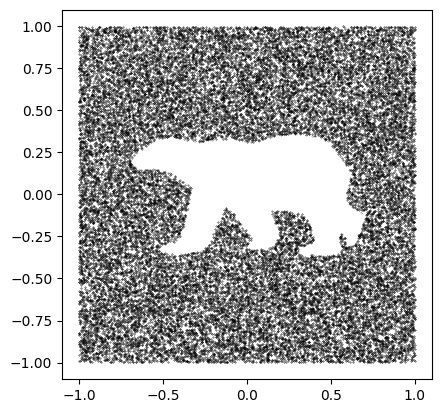

Epoch 39. Training Loss: 0.019893929362297058
Epoch 39. Validation Loss: 0.02137085131019544

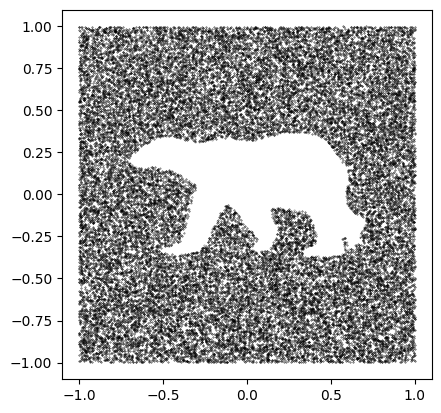

Epoch 40. Training Loss: 0.004015895538032055
Epoch 40. Validation Loss: 0.016632792296682953

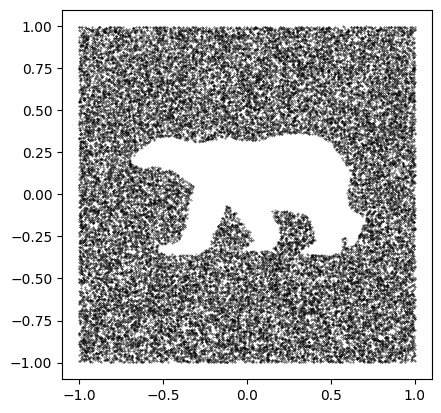

Epoch 41. Training Loss: 0.009160353802144527
Epoch 41. Validation Loss: 0.023861336859927817

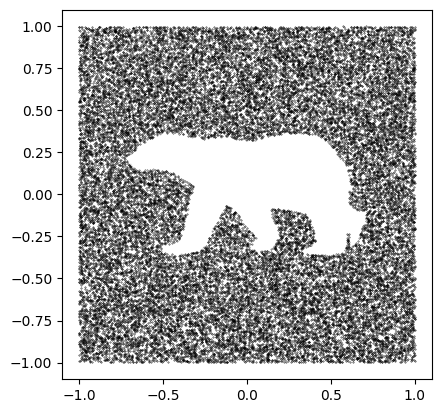

Epoch 42. Training Loss: 0.0025631661992520094
Epoch 42. Validation Loss: 0.017913370375420637

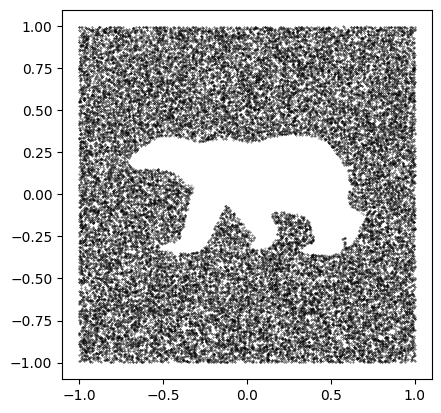

Epoch 43. Training Loss: 0.0026747295632958412
Epoch 43. Validation Loss: 0.01696281676079817

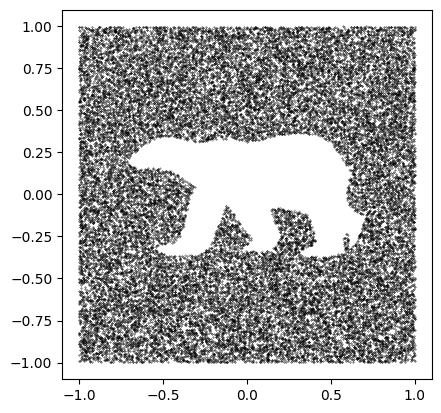

Epoch 44. Training Loss: 0.0008627511560916901
Epoch 44. Validation Loss: 0.013469986095549953

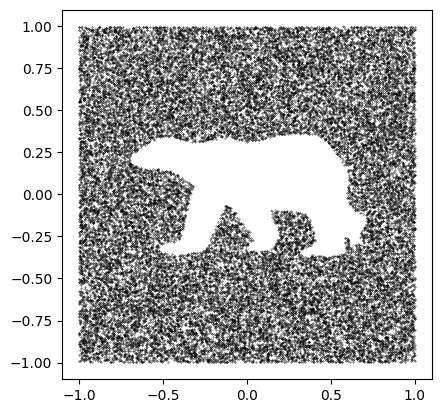

Epoch 45. Training Loss: 0.0038728653453290462
Epoch 45. Validation Loss: 0.01602635262118783

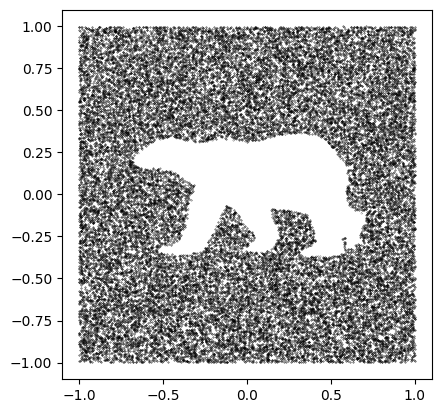

Epoch 46. Training Loss: 0.06918476521968842
Epoch 46. Validation Loss: 0.016084869955755345

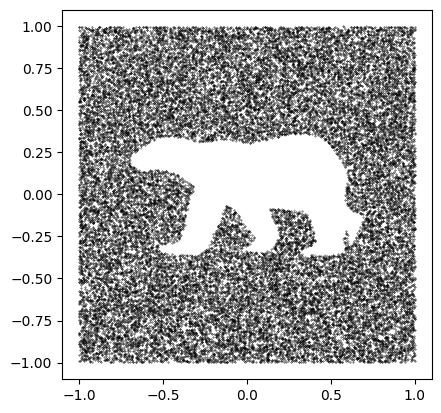

Epoch 47. Training Loss: 0.0001413422723999247
Epoch 47. Validation Loss: 0.01965566653354912

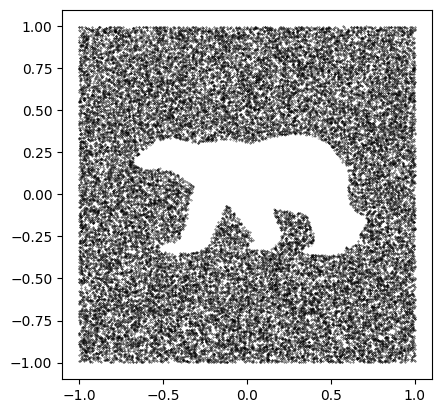

Epoch 48. Training Loss: 0.045958101749420166
Epoch 48. Validation Loss: 0.014623894053659622

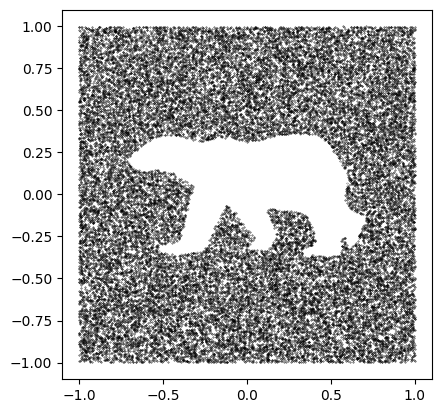

Epoch 49. Training Loss: 0.01757175475358963
Epoch 49. Validation Loss: 0.014363987430645401

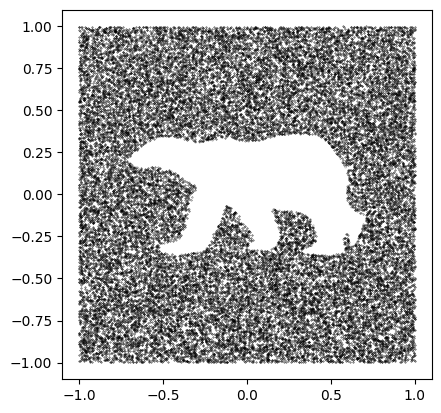

Epoch 50. Training Loss: 0.13725027441978455
Epoch 50. Validation Loss: 0.013503873424165569

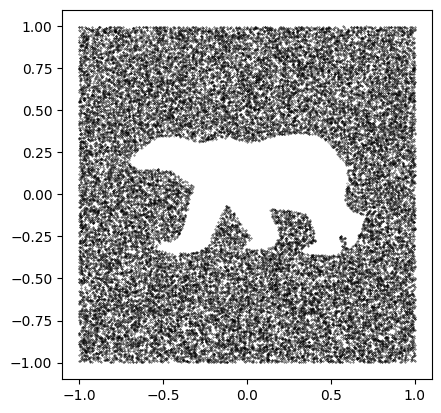

Epoch 51. Training Loss: 0.038247980177402496
Epoch 51. Validation Loss: 0.017861115704676148

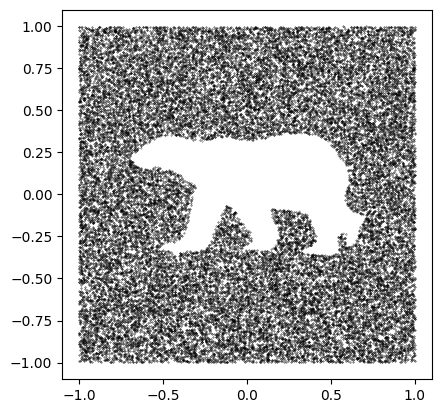

Epoch 52. Training Loss: 0.006031895522028208
Epoch 52. Validation Loss: 0.01845891156773658

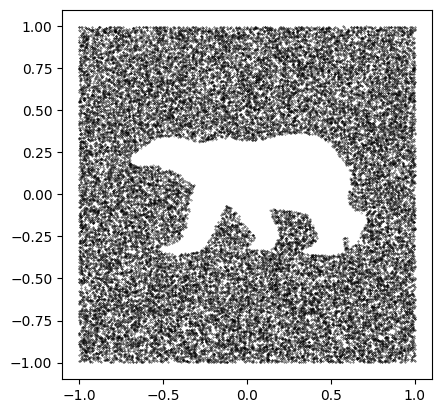

Epoch 53. Training Loss: 0.000731209060177207
Epoch 53. Validation Loss: 0.01854971260022206

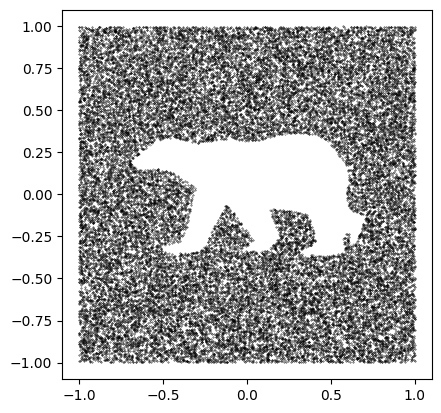

Epoch 54. Training Loss: 7.966198609210551e-05
Epoch 54. Validation Loss: 0.015717144984348563

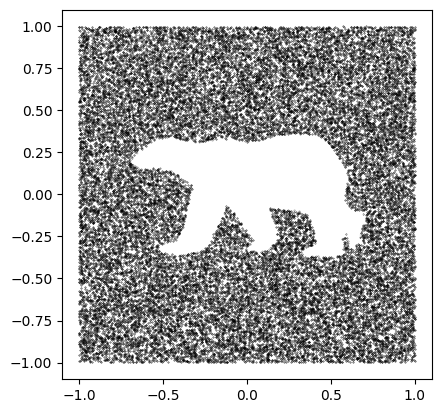

Epoch 55. Training Loss: 0.027393706142902374
Epoch 55. Validation Loss: 0.01677970369909979

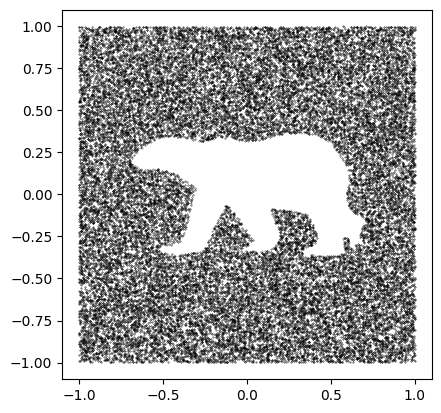

Epoch 56. Training Loss: 0.003453484270721674
Epoch 56. Validation Loss: 0.01897848639518592

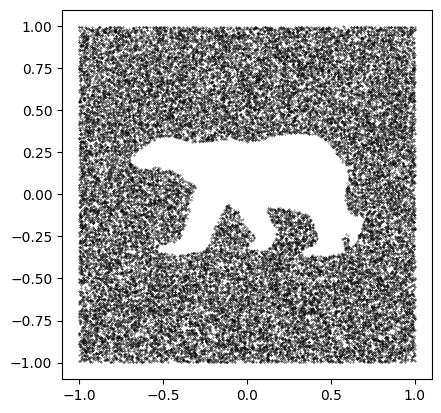

Epoch 57. Training Loss: 0.0454874262213707
Epoch 57. Validation Loss: 0.019274315256981332

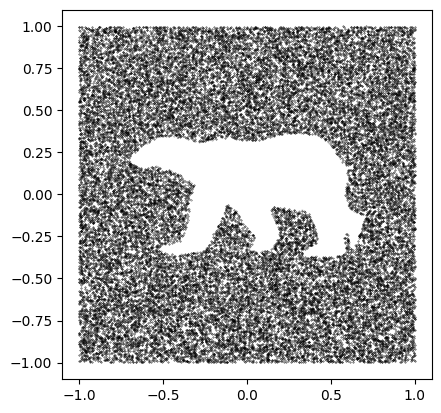

Epoch 58. Training Loss: 0.006140222307294607
Epoch 58. Validation Loss: 0.013994459893293442

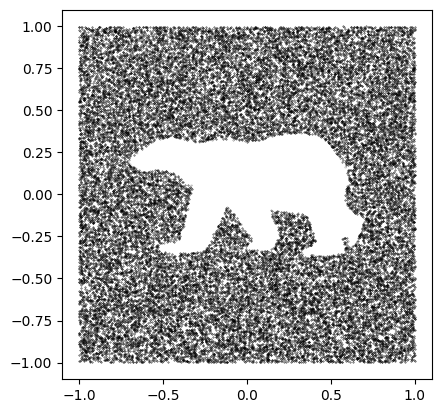

Epoch 59. Training Loss: 0.07846522331237793
Epoch 59. Validation Loss: 0.014525411994593918

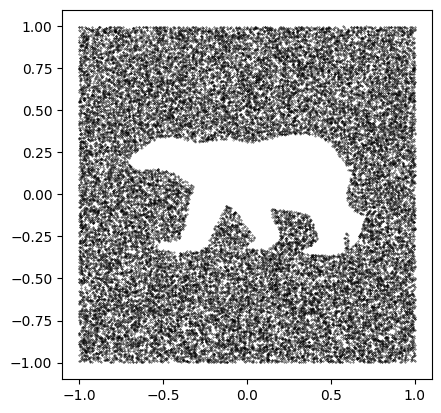

Epoch 60. Training Loss: 0.0001588349259691313
Epoch 60. Validation Loss: 0.015716555771554352

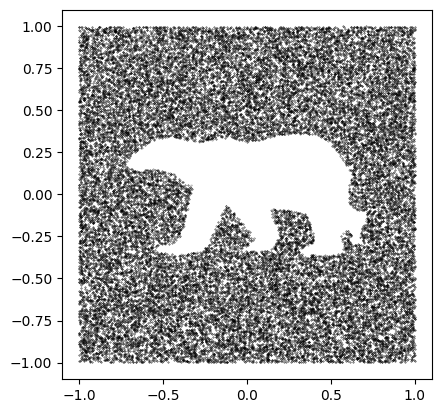

Epoch 61. Training Loss: 0.00011048461601603776
Epoch 61. Validation Loss: 0.01708625532259607

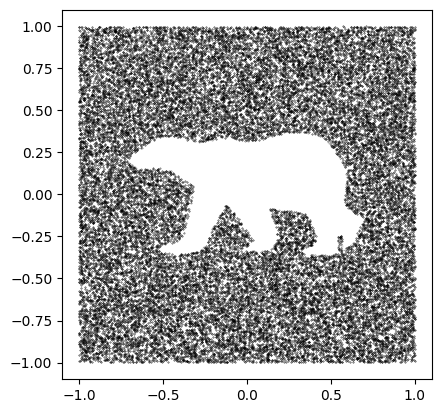

Epoch 62. Training Loss: 0.01670566201210022
Epoch 62. Validation Loss: 0.014938989262671986

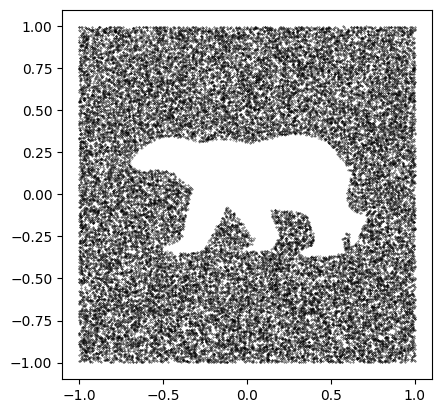

Epoch 63. Training Loss: 0.003940707538276911
Epoch 63. Validation Loss: 0.017222064315893088

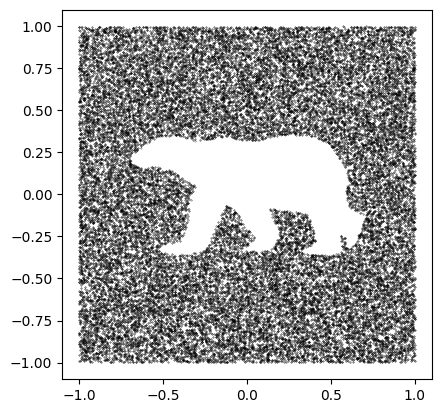

Epoch 64. Training Loss: 3.8305202565425134e-08
Epoch 64. Validation Loss: 0.017264959918465585

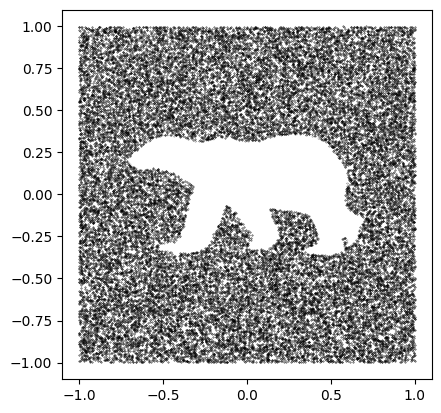

Epoch 65. Training Loss: 0.0450618602335453
Epoch 65. Validation Loss: 0.014046585483915486

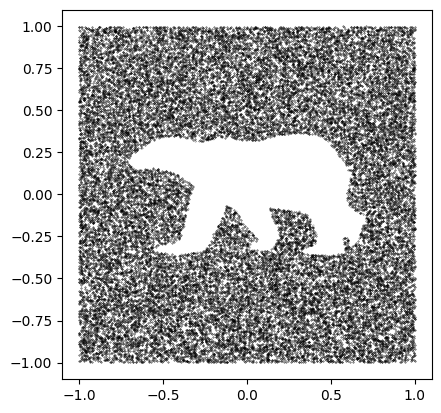

Epoch 66. Training Loss: 0.02528633549809456
Epoch 66. Validation Loss: 0.013047136318911412

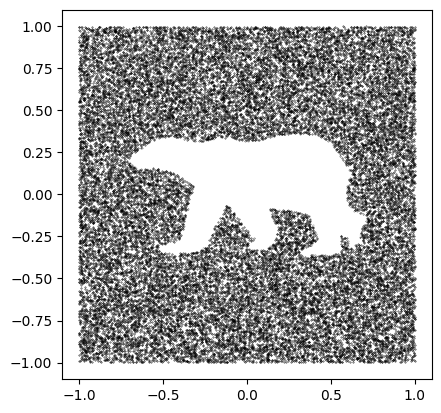

Epoch 67. Training Loss: 0.07316504418849945
Epoch 67. Validation Loss: 0.014276492367884155

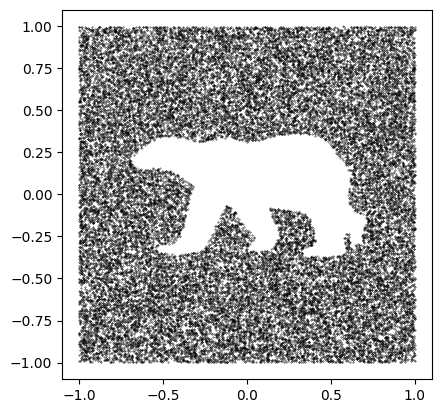

Epoch 68. Training Loss: 0.0025497591122984886
Epoch 68. Validation Loss: 0.017136968624819615

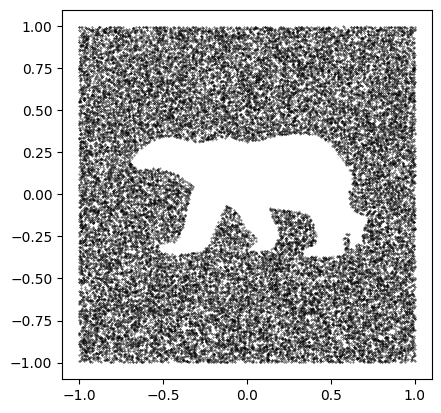

Epoch 69. Training Loss: 0.00017524826398584992
Epoch 69. Validation Loss: 0.013931080034583997

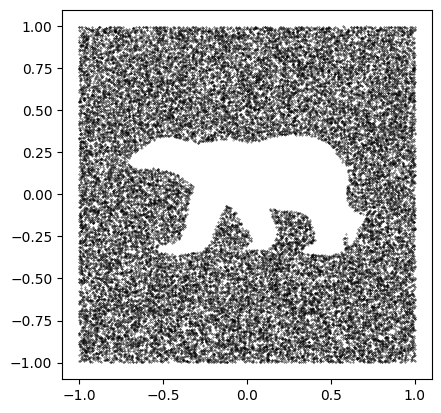

Epoch 70. Training Loss: 0.05198804661631584
Epoch 70. Validation Loss: 0.014171278400785603

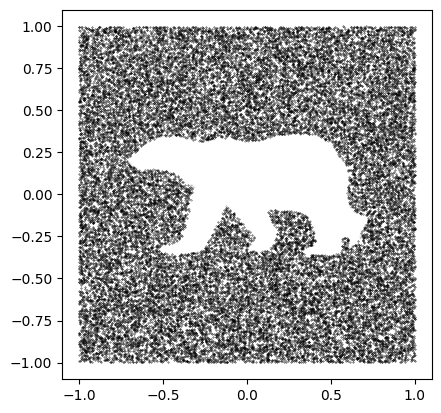

Epoch 71. Training Loss: 0.0003596658061724156
Epoch 71. Validation Loss: 0.011965625605006127

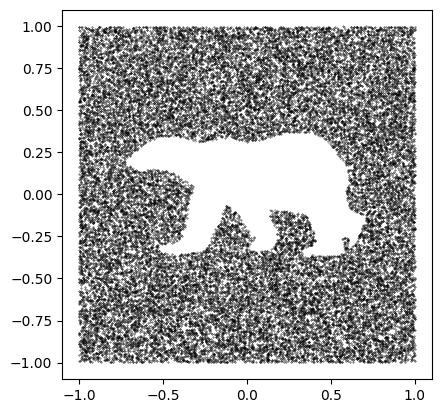

Epoch 72. Training Loss: 0.003386029275134206
Epoch 72. Validation Loss: 0.012424285244789852

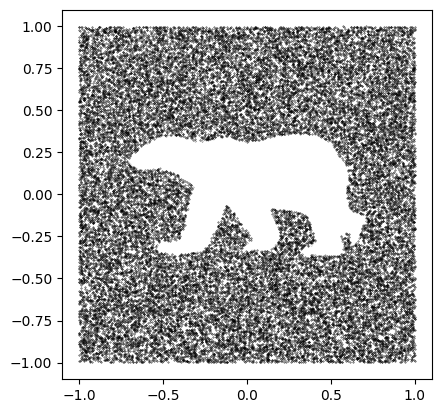

Epoch 73. Training Loss: 0.016830220818519592
Epoch 73. Validation Loss: 0.012803349525305876

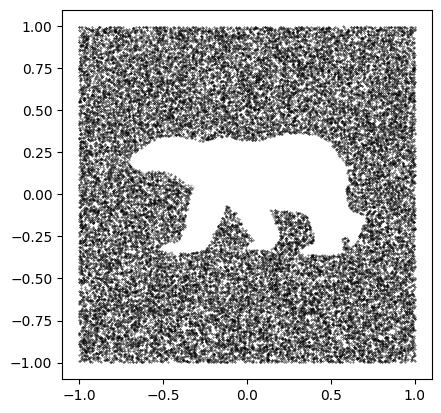

Epoch 74. Training Loss: 3.188104528817348e-05
Epoch 74. Validation Loss: 0.01434239308545544

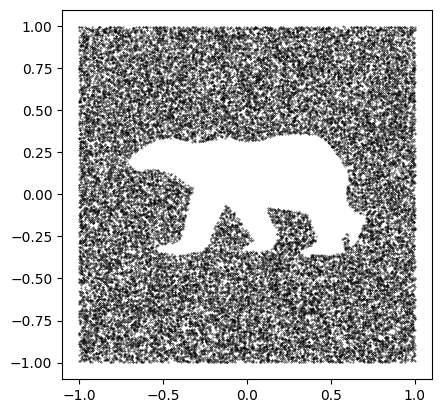

Epoch 75. Training Loss: 0.007077361457049847
Epoch 75. Validation Loss: 0.019669294357299805

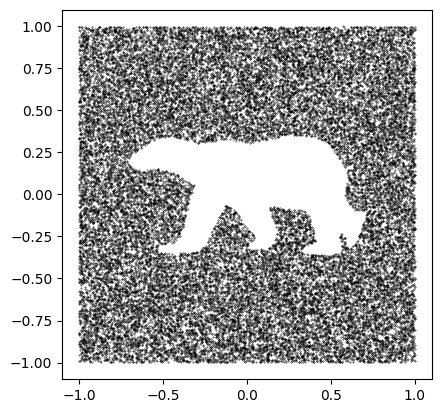

Epoch 76. Training Loss: 0.11715175211429596
Epoch 76. Validation Loss: 0.012552492178169785

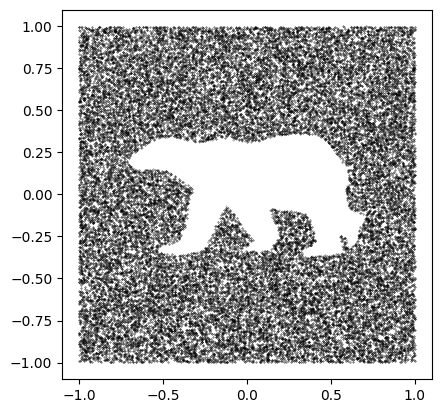

Epoch 77. Training Loss: 3.215710967197083e-05
Epoch 77. Validation Loss: 0.02151229578977937

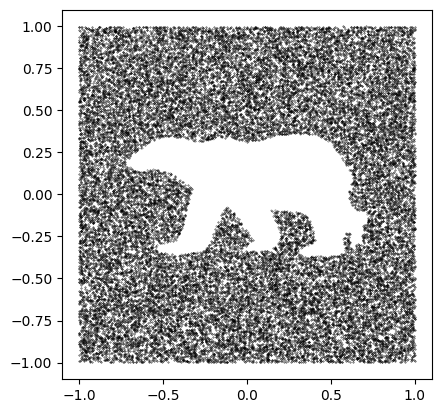

Epoch 78. Training Loss: 0.042427077889442444
Epoch 78. Validation Loss: 0.019696584932363717

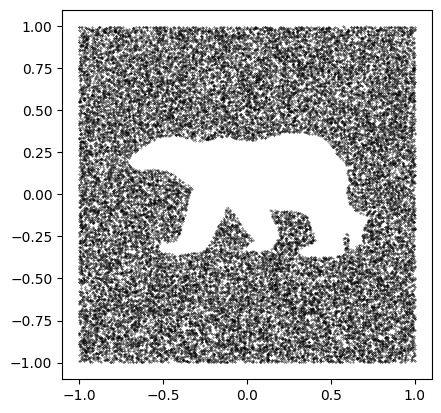

Epoch 79. Training Loss: 0.009632345288991928
Epoch 79. Validation Loss: 0.018259297510620894

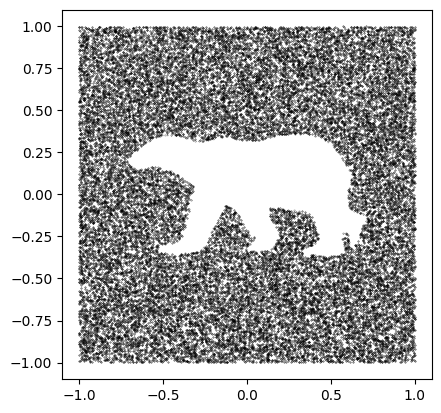

Epoch 80. Training Loss: 3.8953365333327383e-07
Epoch 80. Validation Loss: 0.01647137684427249

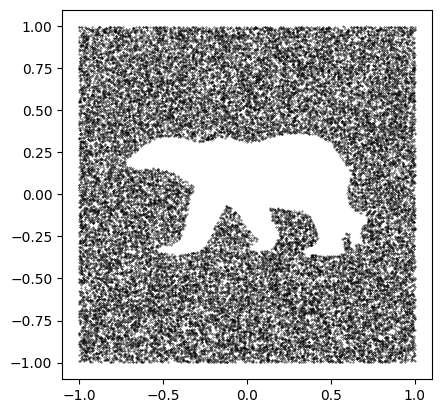

Epoch 81. Training Loss: 0.0002982556470669806
Epoch 81. Validation Loss: 0.02450170031019077

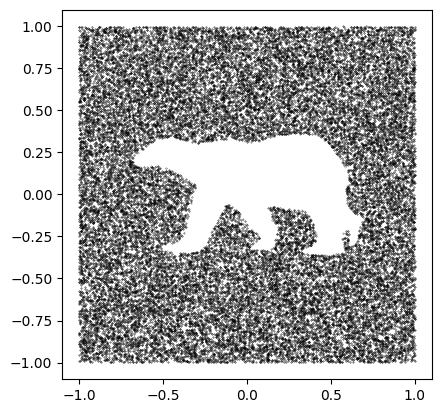

Epoch 82. Training Loss: 0.018937326967716217
Epoch 82. Validation Loss: 0.0142144564610378

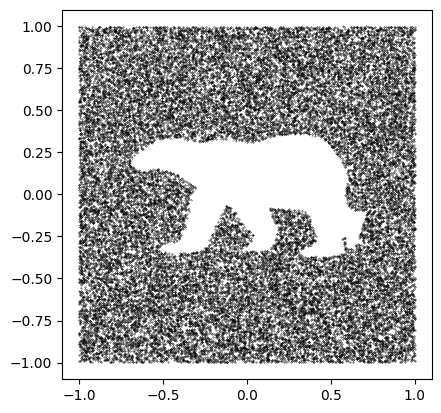

Epoch 83. Training Loss: 0.004202628042548895
Epoch 83. Validation Loss: 0.011954238460322095

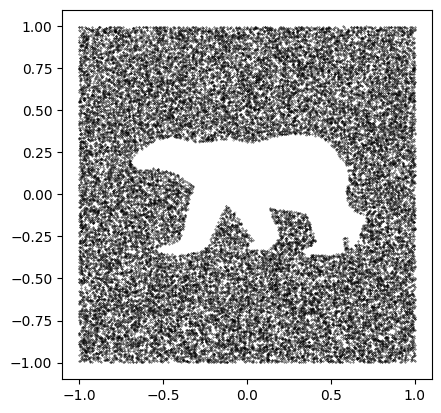

Epoch 84. Training Loss: 0.05665149167180061
Epoch 84. Validation Loss: 0.012569247537357792

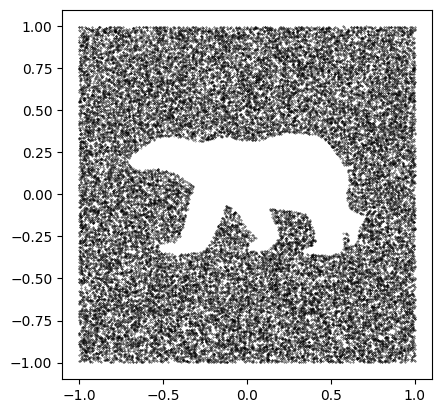

Epoch 85. Training Loss: 0.00012418135884217918
Epoch 85. Validation Loss: 0.013411253121248476

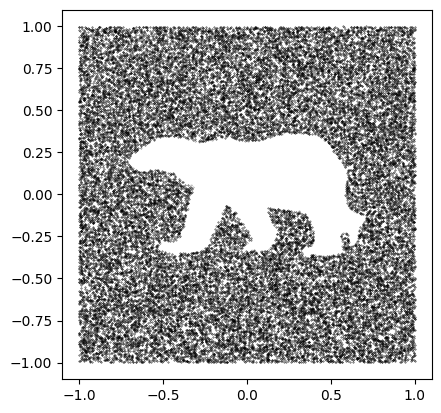

Epoch 86. Training Loss: 0.0014277789741754532
Epoch 86. Validation Loss: 0.013224711084062127

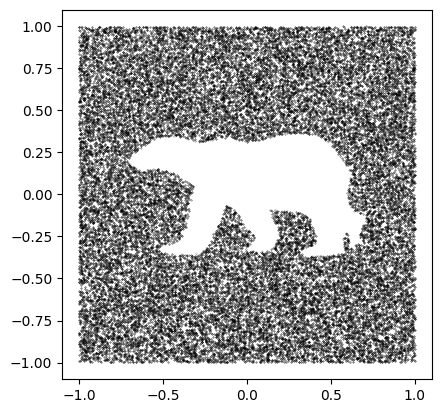

Epoch 87. Training Loss: 3.828909029834904e-05
Epoch 87. Validation Loss: 0.01614195526025857

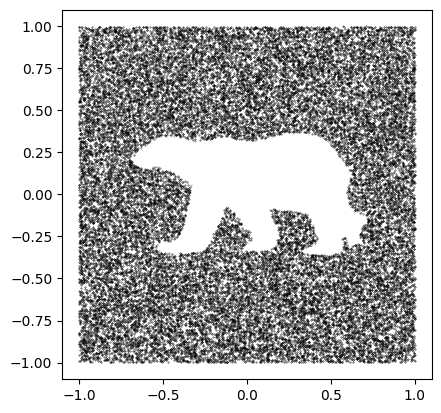

Epoch 88. Training Loss: 1.213562086377351e-06
Epoch 88. Validation Loss: 0.012671303597225505

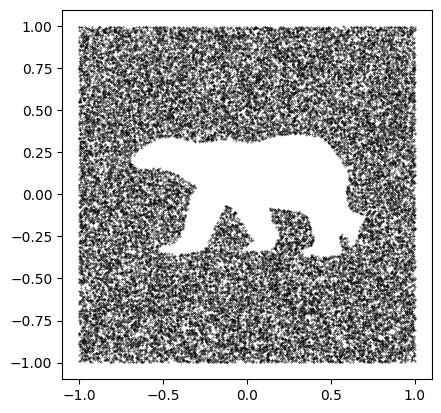

Epoch 89. Training Loss: 6.289601878961548e-05
Epoch 89. Validation Loss: 0.013996616290633087

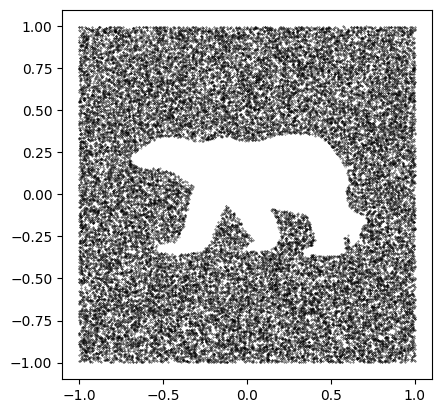

Epoch 90. Training Loss: 0.0008908393210731447
Epoch 90. Validation Loss: 0.015020788095559285

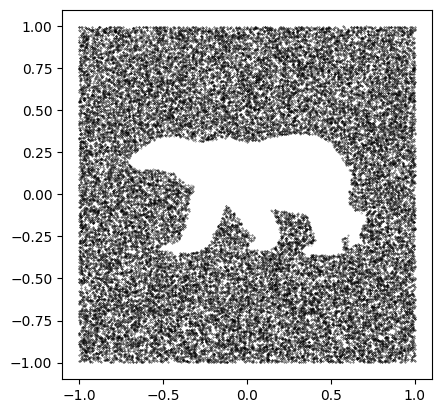

Epoch 91. Training Loss: 0.013038304634392262
Epoch 91. Validation Loss: 0.011862689522421284

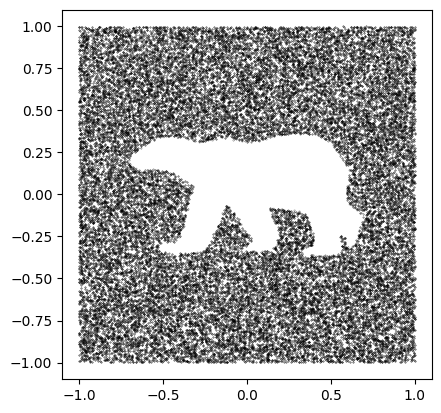

Epoch 92. Training Loss: 0.06335878372192383
Epoch 92. Validation Loss: 0.011720177474295258

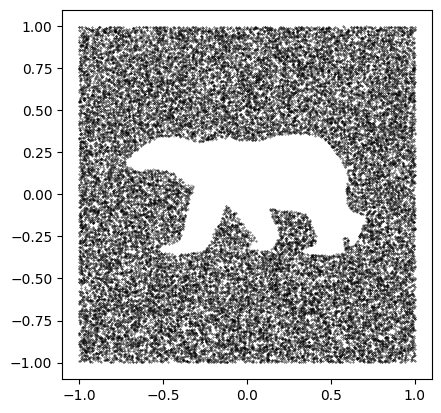

Epoch 93. Training Loss: 4.374555544472969e-07
Epoch 93. Validation Loss: 0.01616429371438968

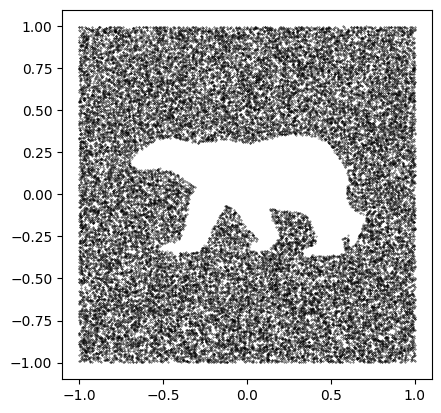

Epoch 94. Training Loss: 0.007949650287628174
Epoch 94. Validation Loss: 0.01134057940950819

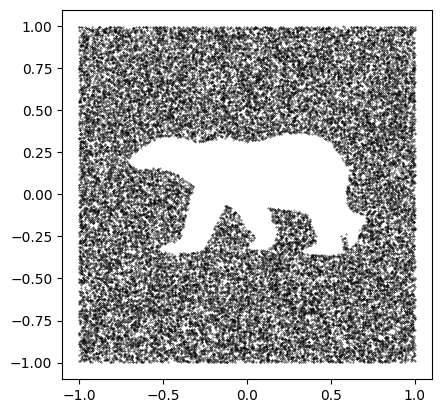

Epoch 95. Training Loss: 0.0007428942481055856
Epoch 95. Validation Loss: 0.015927418022398734

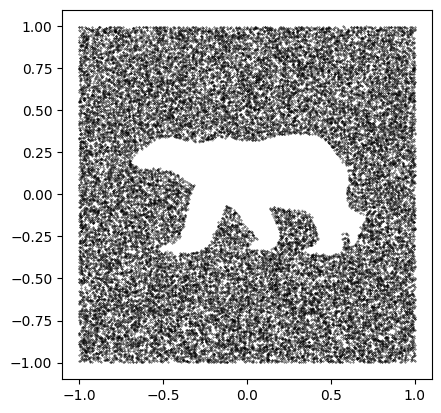

Epoch 96. Training Loss: 0.004984229803085327
Epoch 96. Validation Loss: 0.010188412514461833

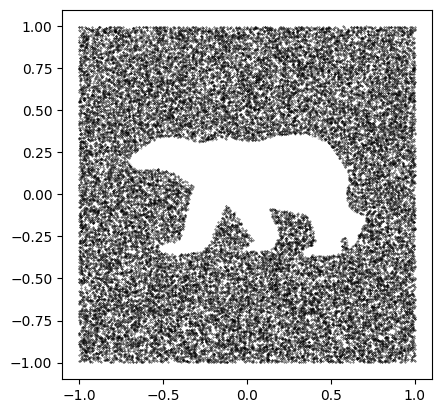

Epoch 97. Training Loss: 0.0012320445384830236
Epoch 97. Validation Loss: 0.014327598984833736

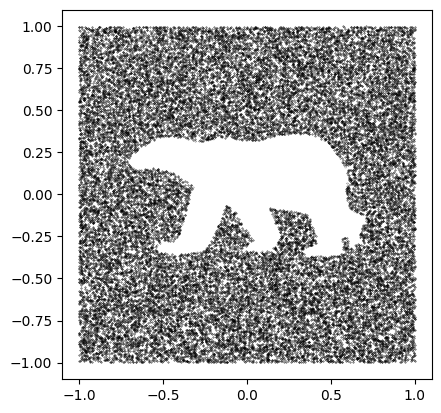

Epoch 98. Training Loss: 0.00964762456715107
Epoch 98. Validation Loss: 0.010586365013365533

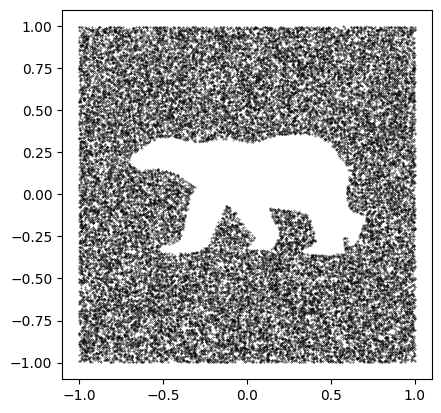

Epoch 99. Training Loss: 0.02293001487851143
Epoch 99. Validation Loss: 0.012649147373855493

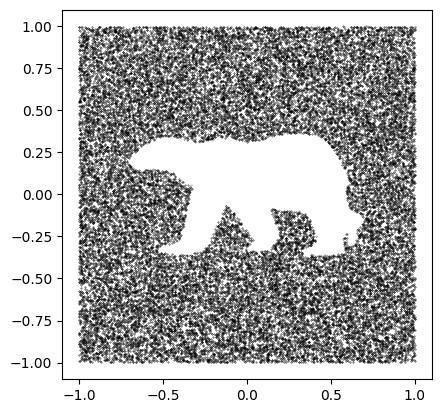

In [14]:
model = torch.nn.Sequential(
    torch.nn.Linear(2, 100),
    torch.nn.LeakyReLU(),
    torch.nn.Linear(100, 100),
    torch.nn.LeakyReLU(),
    torch.nn.Linear(100, 100),
    torch.nn.LeakyReLU(),
    torch.nn.Linear(100, 100),
    torch.nn.LeakyReLU(),
    torch.nn.Linear(100, 1),
    torch.nn.Sigmoid(),
).cuda()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
criterion = torch.nn.BCELoss()
losses=[]
validation_accuracy = []
test_accuracy = []
for epoch in range(100):
    plt.clf()
    for points, labels in train_loader:
        preds = model(points.cuda())
        loss = criterion(preds, labels.cuda())
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        sys.stdout.write(f'\rEpoch {epoch}. Training Loss: {loss.item()}')
        sys.stdout.flush()
    losses.append(loss.detach().cpu().numpy())

    with torch.no_grad():
        total_val_loss = 0.0
        acc_avg = 0
        for points, labels in val_loader:
            preds = model(points.cuda())
            total_val_loss += criterion(preds, labels.cuda())
            preds = preds.squeeze(1).detach().cpu().numpy()
            points = points.detach().numpy()

            acc = 0
            for i in range(preds.shape[0]):
              if labels[i]==0 and preds[i]<0.5:
                 acc+=1
              elif labels[i]==1 and preds[i]>=0.5:
                acc+=1
            acc = acc/128
            acc_avg += acc
            plt.scatter(points[preds >= 0.5, 0], points[preds >= 0.5, 1], c='white', s=0.1)
            plt.scatter(points[preds < 0.5, 0], points[preds < 0.5, 1], c='black', s=0.1)
        validation_accuracy.append(acc_avg/len(val_loader))

        avg_val_loss = total_val_loss.item() / len(val_loader)
        print()
        sys.stdout.write(f'\rEpoch {epoch}. Validation Loss: {avg_val_loss}')
        sys.stdout.flush()
    avg_test_total = []
    with torch.no_grad():
        total_test_loss = 0.0
        acc_avg_test = 0
        for points, labels in test_loader:
            preds = model(points.cuda())
            total_test_loss += criterion(preds, labels.cuda())
            preds = preds.squeeze(1).detach().cpu().numpy()
            #if points[preds>=0.5, 0]
            #pred+=1

            acc_test = 0
            for i in range(preds.shape[0]):
              if labels[i]==0 and preds[i]<0.5:
                acc_test+=1
              elif labels[i]==1 and preds[i]>=0.5:
                acc_test+=1
            acc_test = acc_test/128
            acc_avg_test += acc_test

            points = points.detach().numpy()
            labels=labels.squeeze()
            plt.scatter(points[preds >= 0.5, 0], points[preds >= 0.5, 1], c='white', s=0.1)
            plt.scatter(points[preds < 0.5, 0], points[preds < 0.5, 1], c='black', s=0.1)
            avg_test_loss = total_test_loss.item() / len(test_loader)
            avg_test_total.append(avg_test_loss)
        test_accuracy.append(acc_avg_test/len(test_loader))

        #sys.stdout.write(f'\rEpoch {epoch}. Testing Loss: {avg_test_loss}')
        sys.stdout.flush()
    plt.axis('square')
    plt.show()

Text(0, 0.5, 'Loss')

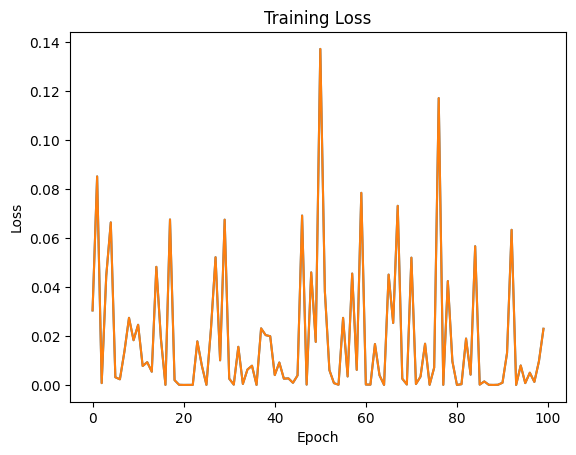

In [15]:
import matplotlib.pyplot as plt

#plt.figure(figsize=(12, 4))
#plt.subplot(1, 2, 1)
plt.plot(range(len(losses)), losses)
plt.title('Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')

plt.plot(range(len(losses)), losses)
plt.title('Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')

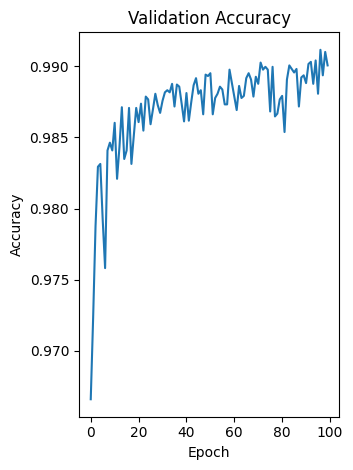

In [16]:
plt.subplot(1, 2, 2)
plt.plot(range(len(validation_accuracy)), validation_accuracy)
plt.title('Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')

plt.tight_layout()
plt.show()

In [17]:
#the testing accuracy of the final model of the MLP classifier
print(test_accuracy[-1])

0.9899482484076433
